In [2]:
#importing some useful packages
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import cv2
%matplotlib inline

In [3]:
import glob

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9, 0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/*.jpg')

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = mpimg.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)

def cal_undistort(img):
    # Use cv2.calibrateCamera() and cv2.undistort()
#     gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
#     ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
#     img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
    
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist

In [5]:
def print2ims(im1, im2, text1='Original Image', text2='Changed Image'):
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(im1, cmap='gray')
    ax1.set_title(text1, fontsize=50)
    ax2.imshow(im2, cmap='gray')
    ax2.set_title(text2, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

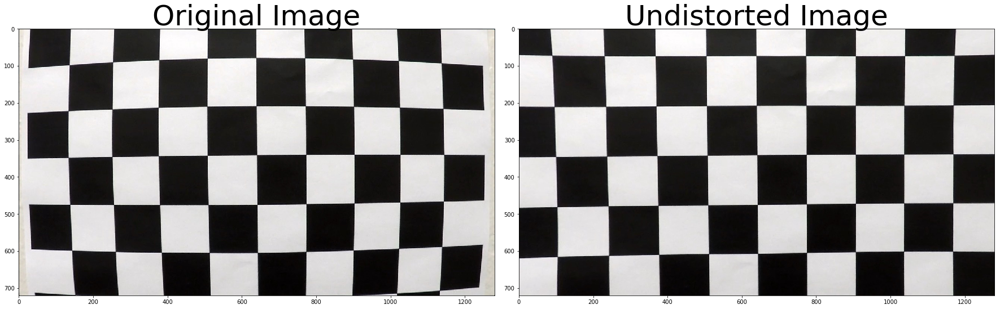

In [482]:
test_cal = mpimg.imread('camera_cal/calibration1.jpg')
undistorted = cal_undistort(test_cal)
print2ims(test_cal, undistorted, text2='Undistorted Image')

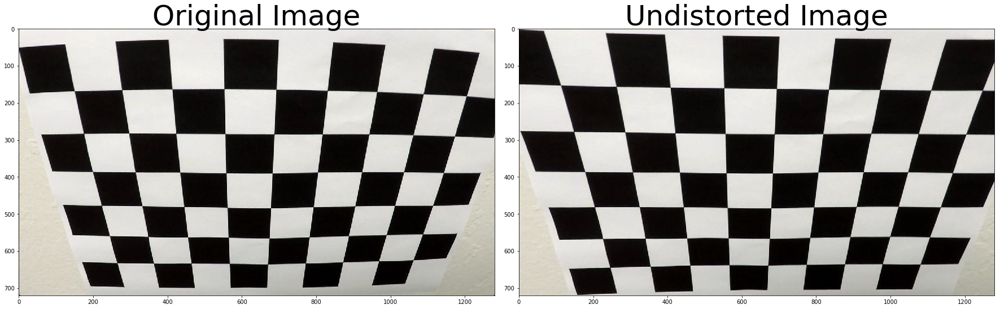

In [483]:
test_cal2 = mpimg.imread('camera_cal/calibration2.jpg')
undistorted2 = cal_undistort(test_cal2)
print2ims(test_cal2, undistorted2, text2='Undistorted Image')

In [47]:
bottom_left = [220,720]
bottom_right = [1110, 720]
top_left = [570, 470]
top_right = [722, 470]

src = np.float32([bottom_left,bottom_right,top_right,top_left])

bottom_left2 = [320,720]
bottom_right2 = [920, 720]
top_left2 = [320, 1]
top_right2 = [920, 1]

dst = np.float32([bottom_left2,bottom_right2,top_right2,top_left2])

In [34]:
img_size = (1280, 720)
bottom_left3 = [(img_size[0] / 2) - 55, img_size[1] / 2 + 100]
bottom_right3  =  [((img_size[0] / 6) - 10), img_size[1]]
top_left3 =    [(img_size[0] * 5 / 6) + 60, img_size[1]]
top_right3 =   [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]

bottom_left4 = [(img_size[0] / 4), 0]
bottom_right4=    [(img_size[0] / 4), img_size[1]]
top_left4=    [(img_size[0] * 3 / 4), img_size[1]]
top_right4=    [(img_size[0] * 3 / 4), 0]

In [35]:
src2 = np.float32([bottom_left3,bottom_right3,top_right3,top_left3])
dst2 = np.float32([bottom_left4,bottom_right4,top_right4,top_left4])

In [48]:
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)
    
def warp(img):
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped

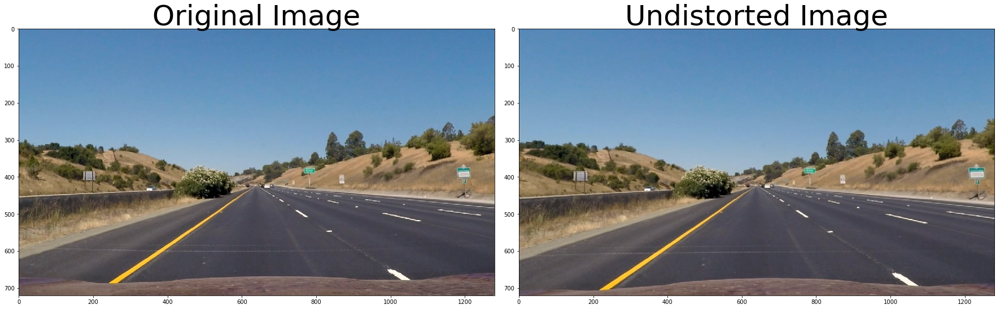

In [500]:
image2 = mpimg.imread('test_images/straight_lines1.jpg')
undistorted = cal_undistort(image2)
print2ims(image2, undistorted, text2='Undistorted Image')

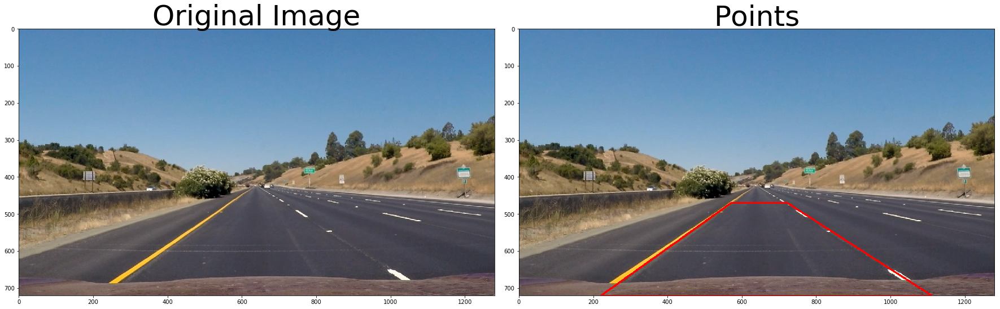

In [501]:
pts = np.array([bottom_left,bottom_right,top_right,top_left], np.int32)
pts = pts.reshape((-1,1,2))
copy = image2.copy()
cv2.polylines(copy,[pts],True,(255,0,0), thickness=3)
print2ims(image2, copy, text2 = 'Points')

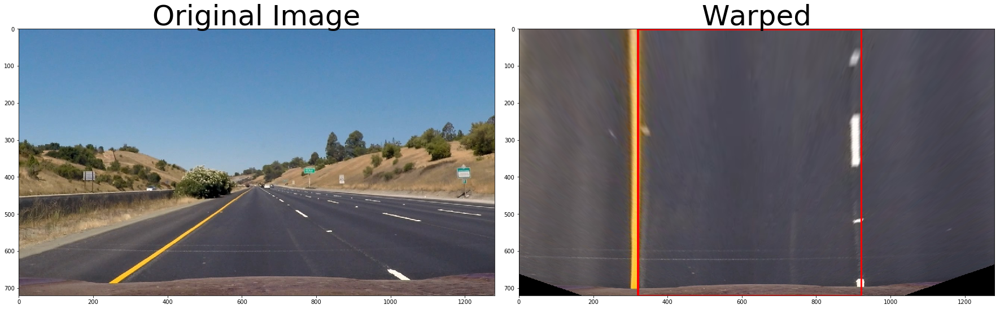

In [502]:
pts = np.array([bottom_left2,bottom_right2,top_right2,top_left2], np.int32)
pts = pts.reshape((-1,1,2))
copy = warp(image2)
cv2.polylines(copy,[pts],True,(255,0,0), thickness=3)
print2ims(image2, copy,text2 = 'Warped')

In [489]:
image = mpimg.imread('test_images/test5.jpg')

In [95]:
kernel_size = 9

In [87]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=15, thresh=(20, 100)):
    # Apply the following steps to img
     # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0,ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1,ksize=sobel_kernel))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # Return the result
    return binary_output

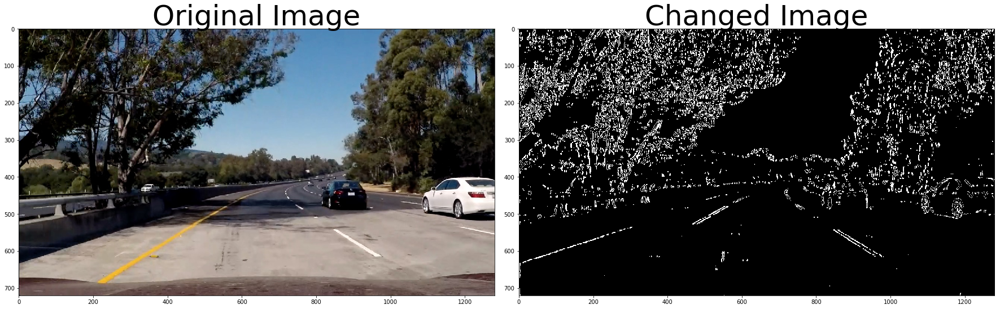

In [402]:
sobelx = abs_sobel_thresh(image, orient='x', sobel_kernel=kernel_size, thresh=(30, 70))
print2ims(image, sobelx)

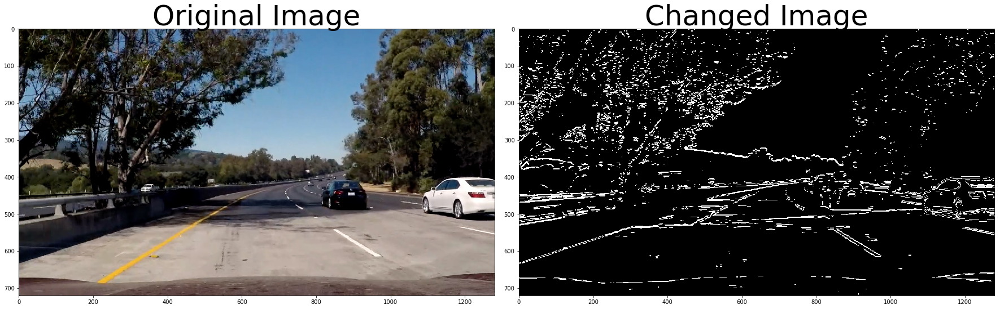

In [385]:
sobely = abs_sobel_thresh(image, orient='y', sobel_kernel=kernel_size, thresh=(40, 100))
print2ims(image, sobely)

In [75]:
def mag_thresh(img, sobel_kernel=9, mag_thresh=(30, 100)):
    
    # Apply the following steps to img
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

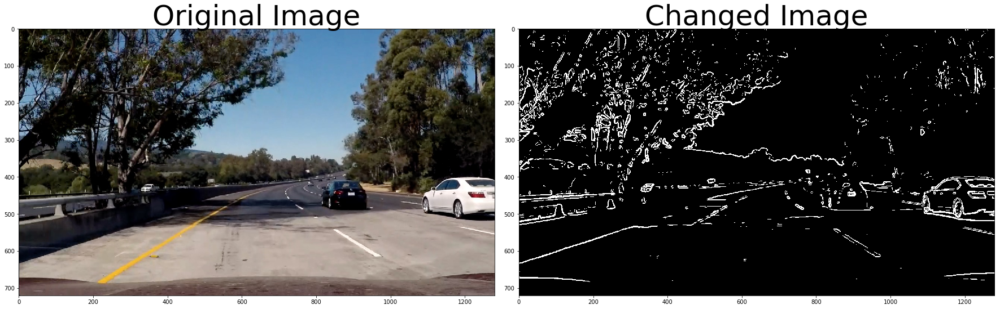

In [399]:
mag_binary = mag_thresh(image, sobel_kernel=kernel_size, mag_thresh=(60, 180))
print2ims(image, mag_binary)

In [83]:
def dir_threshold(img, sobel_kernel=15, thresh=(0, np.pi/2)):
    
    # Apply the following steps to img
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output

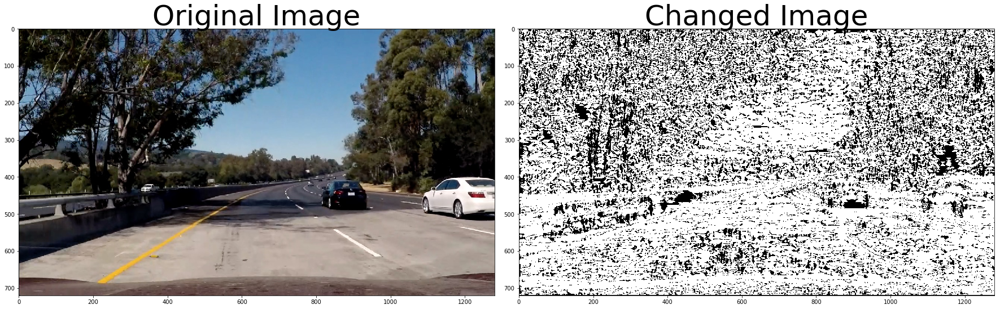

In [351]:
dir_binary = dir_threshold(image, sobel_kernel=kernel_size, thresh=(np.pi/6, np.pi/2))
print2ims(image, dir_binary)

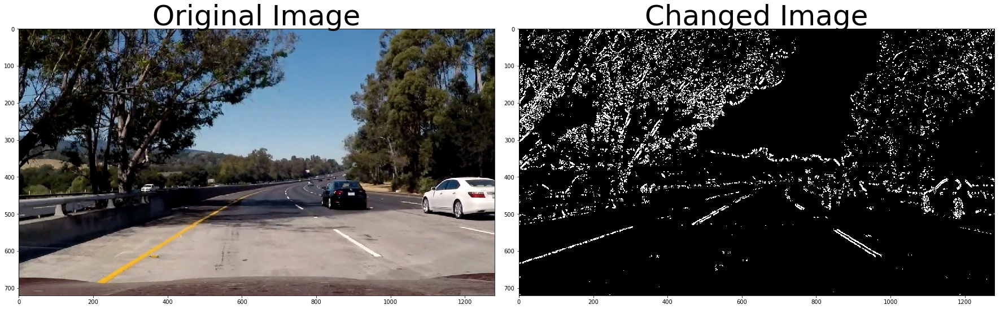

In [212]:
combined = np.zeros_like(dir_binary)
combined[((sobelx == 1) & (sobely == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
print2ims(image, combined)

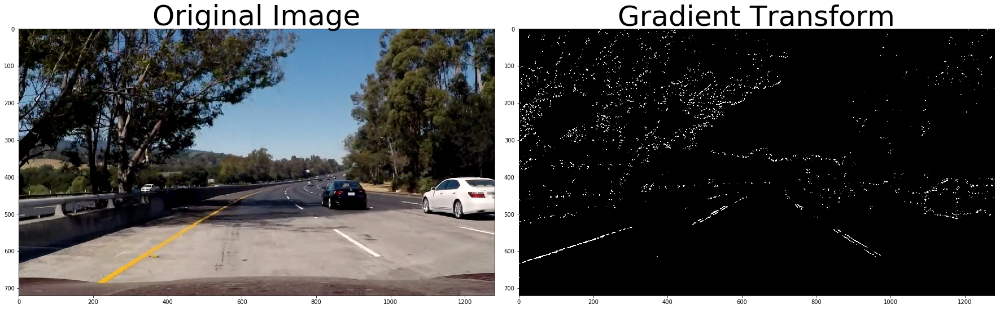

In [490]:
combined2 = np.zeros_like(dir_binary)
combined2[(sobelx == 1) & (mag_binary == 1) & (dir_binary == 1)] = 1
print2ims(image, combined2, text2 = 'Gradient Transform')

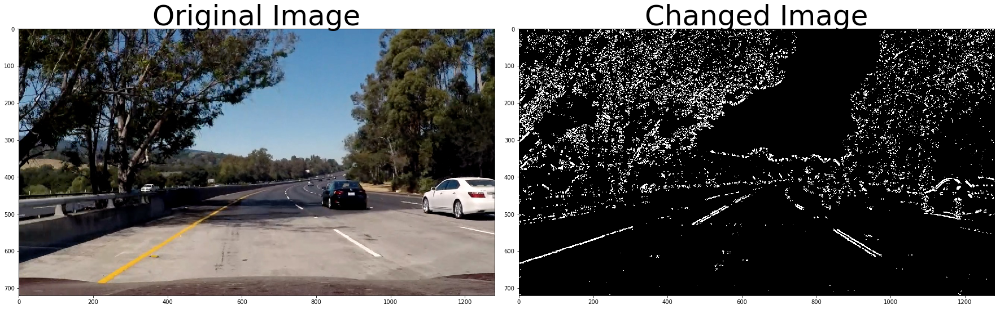

In [359]:
combined3 = np.zeros_like(dir_binary)
combined3[(sobelx == 1) & (dir_binary == 1)] = 1
print2ims(image, combined3)

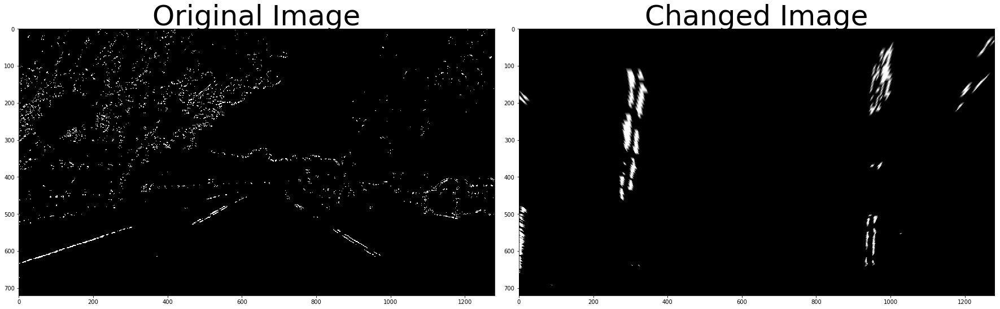

In [487]:
warped = warp(combined2)
print2ims(combined2, warped)

In [114]:
def print3ims(im1, im2, im3, text1='Image1', text2='Image2', text3='Image3'):
    f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(im1, cmap='gray')
    ax1.set_title(text1, fontsize=50)
    ax2.imshow(im2, cmap='gray')
    ax2.set_title(text2, fontsize=50)
    ax3.imshow(im3, cmap='gray')
    ax3.set_title(text3, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

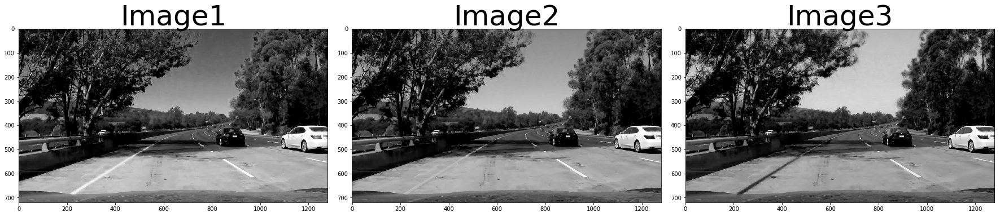

In [217]:
R = image[:,:,0]
G = image[:,:,1]
B = image[:,:,2]
print3ims(R, G, B)

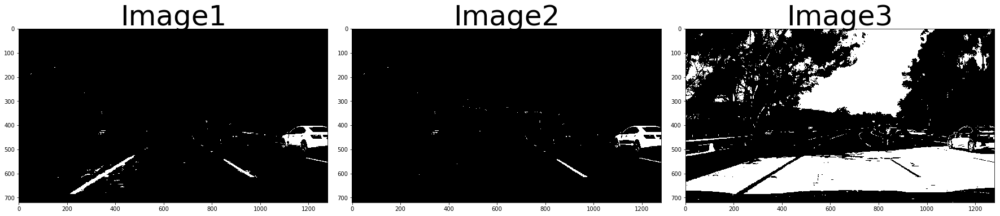

In [223]:
thresh = (200, 255)
binaryR = np.zeros_like(R)
binaryR[(R > thresh[0]) & (R <= thresh[1])] = 1
binaryG = np.zeros_like(G)
binaryG[(G > thresh[0]) & (G <= thresh[1])] = 1
thresh = (120, 220)
binaryB = np.zeros_like(B)
binaryB[(B > thresh[0]) & (B <= thresh[1])] = 1
print3ims(binaryR, binaryG, binaryB)

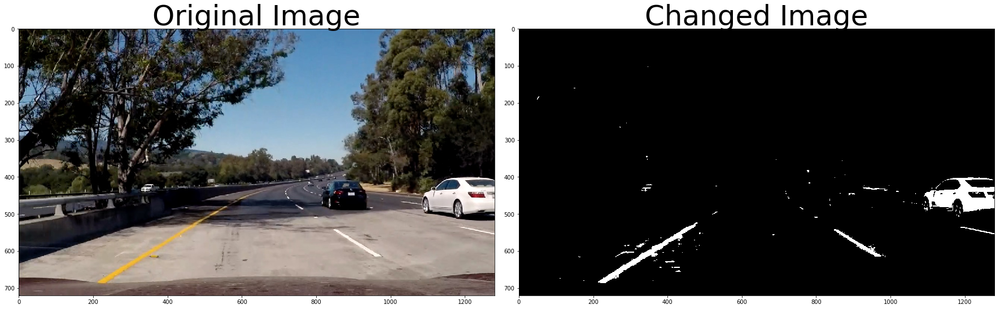

In [225]:
combinedRGB = np.zeros_like(binary1)
combinedRGB[(binaryR == 1) | (binaryG == 1) & (binaryB == 0)] = 1
print2ims(image, combinedRGB)

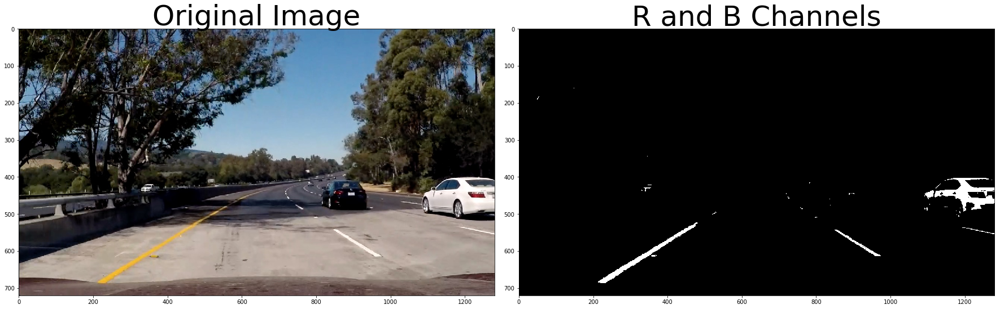

In [491]:
combinedRGB2 = np.zeros_like(binary1)
combinedRGB2[(binaryR == 1) & (binaryB == 0)] = 1
print2ims(image, combinedRGB2, text2 = 'R and B Channels')

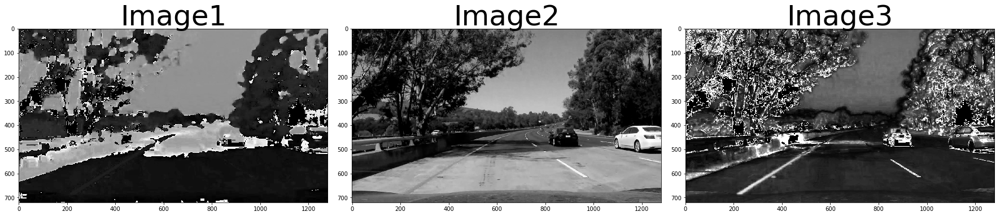

In [226]:
hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
H = hls[:,:,0]
L = hls[:,:,1]
S = hls[:,:,2]
print3ims(H, L, S)

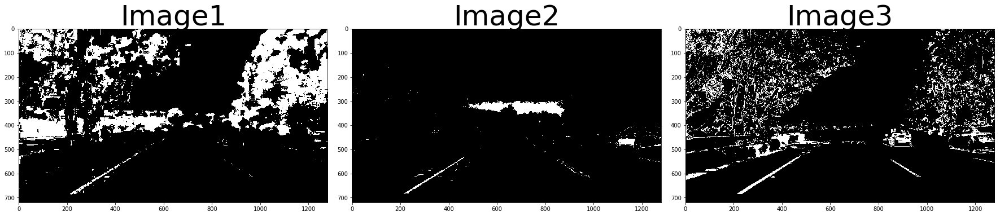

In [496]:
thresh = (20, 90)
binaryH = np.zeros_like(H)
binaryH[(H > thresh[0]) & (H <= thresh[1])] = 1
thresh = (195, 220)
binaryL = np.zeros_like(L)
binaryL[(L > thresh[0]) & (L <= thresh[1])] = 1
thresh = (150, 255)
binaryS = np.zeros_like(S)
binaryS[(S > thresh[0]) & (S <= thresh[1])] = 1
print3ims(binaryH, binaryL, binaryS)

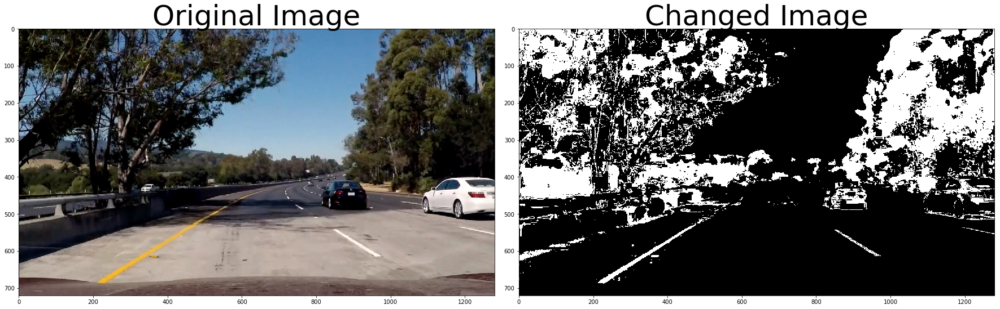

In [405]:
combinedHLS = np.zeros_like(binaryS)
combinedHLS[(binaryS == 1) | (binaryH == 1) & (binaryL == 0)] = 1
print2ims(image, combinedHLS)

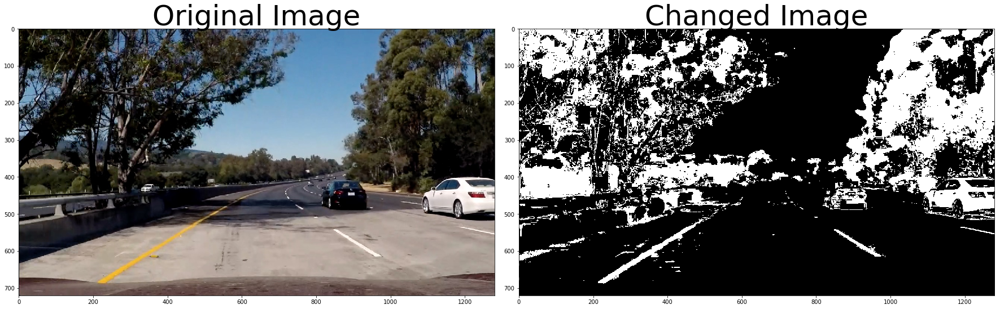

In [257]:
combinedRGB_HLS = np.zeros_like(combinedRGB)
combinedRGB_HLS[(combinedRGB == 1) | (combinedHLS == 1)] = 1
print2ims(image, combinedRGB_HLS)

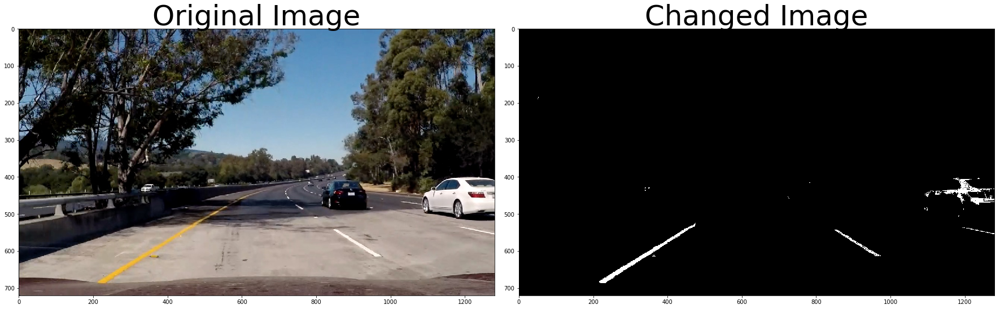

In [430]:
combinedRGB_S = np.zeros_like(combinedRGB2)
combinedRGB_S[(combinedRGB2 == 1) & (binaryS == 1)] = 1
print2ims(image, combinedRGB_S)

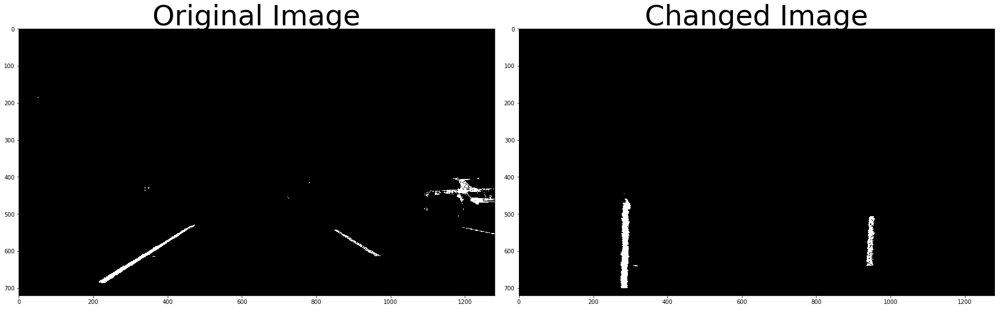

In [335]:
warped = warp(combinedRGB_S)
print2ims(combinedRGB_S, warped)

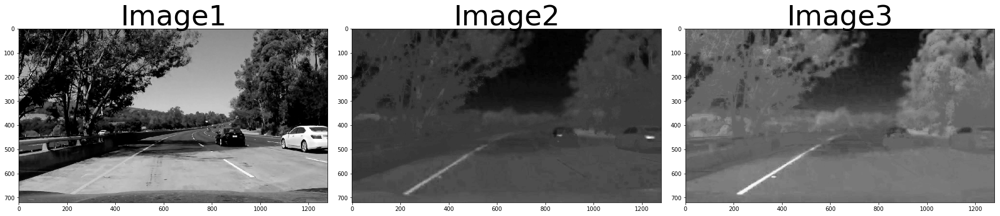

In [277]:
luv = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
L = luv[:,:,0]
U = luv[:,:,1]
V = luv[:,:,2]
print3ims(L, U, V)

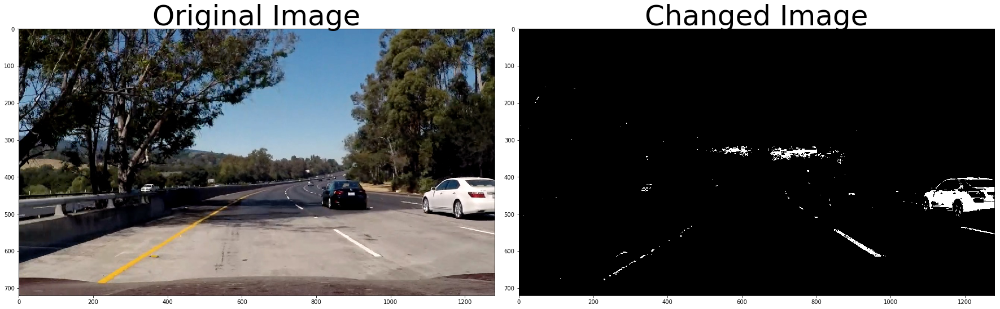

In [338]:
thresh = (200, 250)
binaryL = np.zeros_like(L)
binaryL[(L > thresh[0]) & (L <= thresh[1])] = 1
print2ims(image, binaryL)

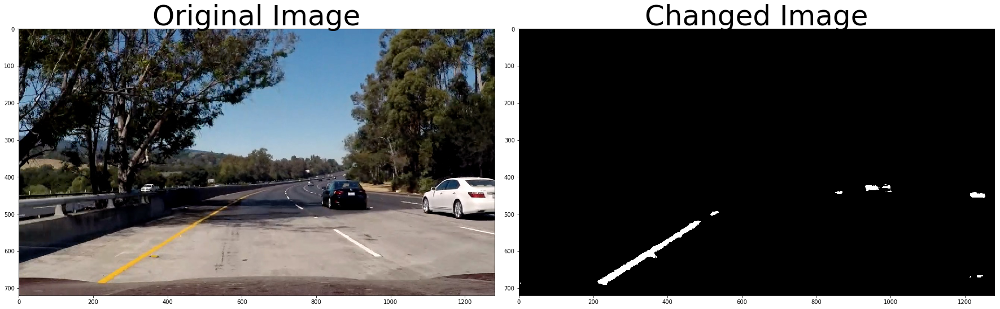

In [333]:
thresh = (110, 170)
binaryU = np.zeros_like(U)
binaryU[(U > thresh[0]) & (U <= thresh[1])] = 1
print2ims(image, binaryU)

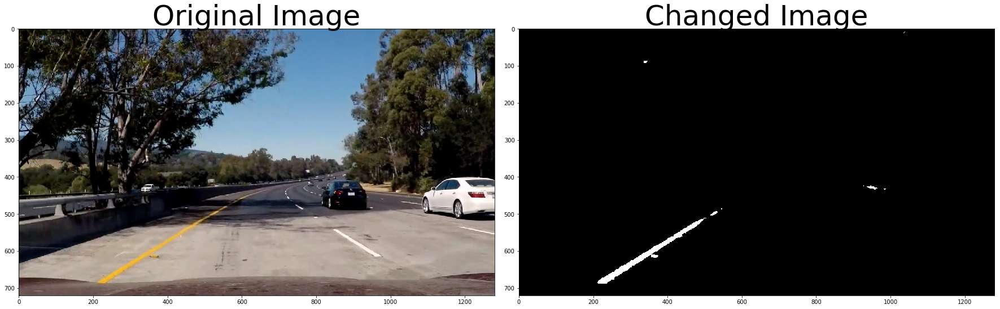

In [298]:
thresh = (165, 255)
binaryV = np.zeros_like(V)
binaryV[(V > thresh[0]) & (V <= thresh[1])] = 1
print2ims(image, binaryV)

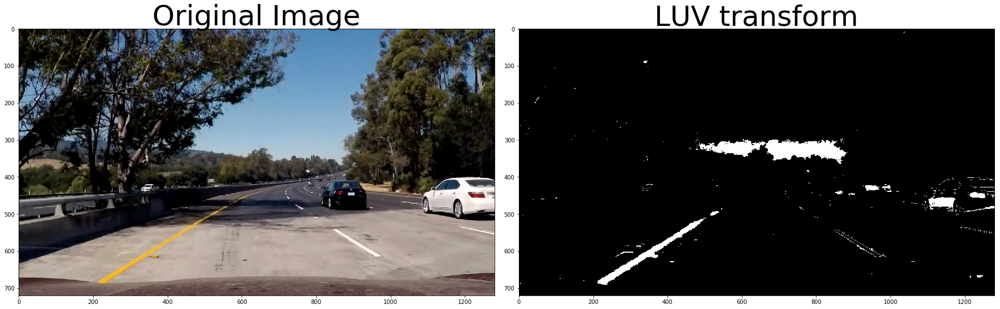

In [497]:
combined_LUV = np.zeros_like(binaryL)
combined_LUV[(binaryL == 1) | (binaryU == 1)| (binaryV == 1)] = 1
print2ims(image, combined_LUV, text2 = 'LUV transform')

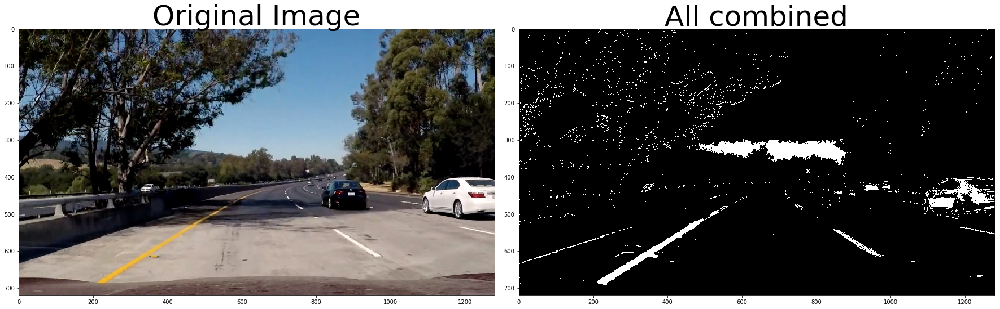

In [498]:
combined_RGB_S_LUV = np.zeros_like(combinedRGB_S)
combined_RGB_S_LUV[(combinedRGB_S == 1) | (combined_LUV == 1) | (combined2 == 1)] = 1
print2ims(image, combined_RGB_S_LUV, text2 = 'All combined')

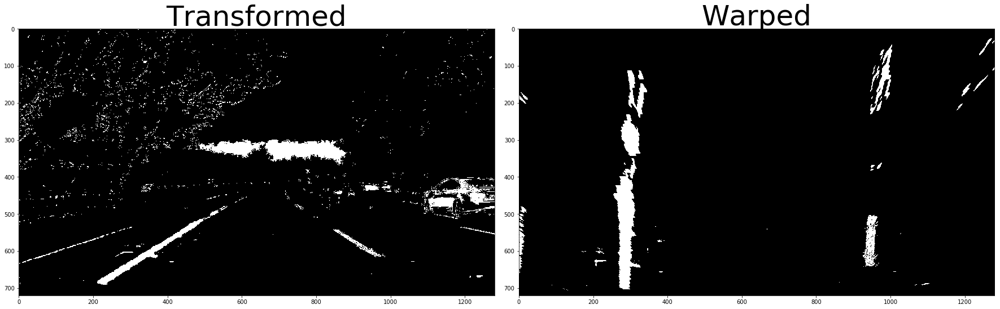

In [580]:
warped = warp(combined_RGB_S_LUV)
print2ims(combined_RGB_S_LUV, warped, text1 = 'Transformed', text2= 'Warped')

In [194]:
def combined_sobel_dir(image):
    sobelx = abs_sobel_thresh(image, orient='x', sobel_kernel=kernel_size, thresh=(20, 200))
    mag_binary = mag_thresh(image, sobel_kernel=kernel_size, mag_thresh=(60, 220))
    dir_binary = dir_threshold(image, sobel_kernel=kernel_size, thresh=(np.pi/6, np.pi/2))
    combined = np.zeros_like(sobelx)
    combined[(sobelx == 1) & (dir_binary == 1)] = 1
    return combined

In [462]:
def gradient_threshold(image):
    
    kernel_size = 3
    sobelx = abs_sobel_thresh(image, orient='x', sobel_kernel=kernel_size, thresh=(30, 100))
    dir_binary = dir_threshold(image, sobel_kernel=kernel_size, thresh=(np.pi/6, np.pi/2))
    mag_binary = mag_thresh(image, sobel_kernel=kernel_size, mag_thresh=(60, 180))
    combined = np.zeros_like(sobelx)
    combined[(sobelx == 1) & (mag_binary == 1) & (dir_binary == 1)] = 1
    
    R = image[:,:,0]
    G = image[:,:,1]
    B = image[:,:,2]
    thresh = (200, 255)
    binaryR = np.zeros_like(R)
    binaryR[(R > thresh[0]) & (R <= thresh[1])] = 1
    binaryG = np.zeros_like(G)
    binaryG[(G > thresh[0]) & (G <= thresh[1])] = 1
    thresh = (120, 220)
    binaryB = np.zeros_like(B)
    binaryB[(B > thresh[0]) & (B <= thresh[1])] = 1
    combinedRGB = np.zeros_like(binaryR)
    combinedRGB[(binaryR == 1) & (binaryB == 0)] = 1
    
    hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]
    thresh = (20, 90)
    binaryH = np.zeros_like(H)
    binaryH[(H > thresh[0]) & (H <= thresh[1])] = 1
    thresh = (155, 200)
    binaryL = np.zeros_like(L)
    binaryL[(L > thresh[0]) & (L <= thresh[1])] = 1
    thresh = (160, 255)
    binaryS = np.zeros_like(S)
    binaryS[(S > thresh[0]) & (S <= thresh[1])] = 1
    
    combinedRGB_S = np.zeros_like(combinedRGB)
    combinedRGB_S[(combinedRGB == 1) & (binaryS == 1)] = 1
    
    luv = cv2.cvtColor(image, cv2.COLOR_RGB2LUV)
    L = luv[:,:,0]
    U = luv[:,:,1]
    V = luv[:,:,2]
    thresh = (200, 250)
    binaryL = np.zeros_like(L)
    binaryL[(L > thresh[0]) & (L <= thresh[1])] = 1
    thresh = (110, 170)
    binaryU = np.zeros_like(U)
    binaryU[(U > thresh[0]) & (U <= thresh[1])] = 1
    thresh = (165, 255)
    binaryV = np.zeros_like(V)
    binaryV[(V > thresh[0]) & (V <= thresh[1])] = 1
    combined_LUV = np.zeros_like(binaryL)
    combined_LUV[(binaryL == 1) | (binaryU == 1)| (binaryV == 1)] = 1

    combined_RGB_S_LUV = np.zeros_like(combinedRGB)
    combined_RGB_S_LUV[(combinedRGB_S == 1) | (combined_LUV == 1) | (combined == 1)] = 1
    #combined_RGB_S_LUV[((combinedRGB == 1) & (combined_LUV == 1)) |  ((binaryS == 1) | (combined == 1))] = 1
    
    return combined_RGB_S_LUV

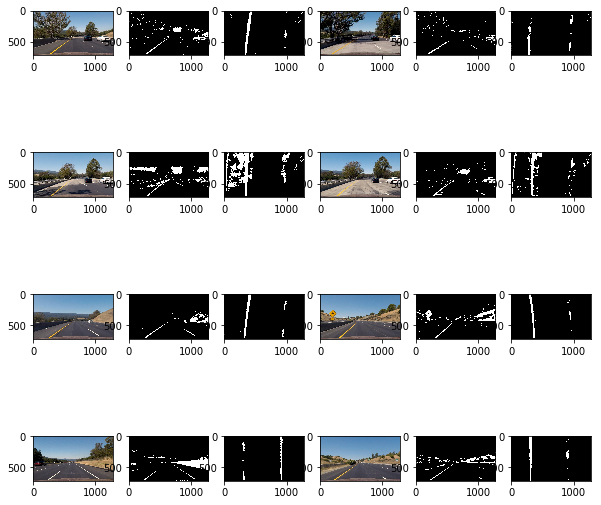

In [463]:
test = glob.glob('test_images/*.jpg')
count = 1
fig=plt.figure(figsize=(10, 10))
for img in test:
    
    image = mpimg.imread(img)
    image = cal_undistort(image)
    fig.add_subplot(4, 6, count)
    plt.imshow(image)
    count += 1
    
    res = gradient_threshold(image)
    fig.add_subplot(4, 6, count)
    plt.imshow(res, cmap = 'gray')
    count += 1
    
    warped = warp(res)
    fig.add_subplot(4, 6, count)
    plt.imshow(warped, cmap = 'gray')
    if(count < 22):
        count += 1
    
plt.show()

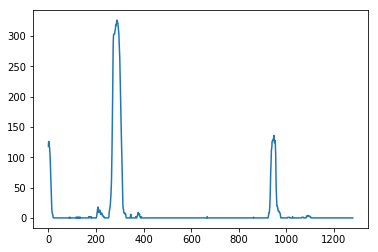

In [567]:
warped = warp(combined_RGB_S_LUV)
histogram = np.sum(warped[warped.shape[0]//2:,:], axis=0)
plt.plot(histogram)
plt.show()

(252, 378, 4)


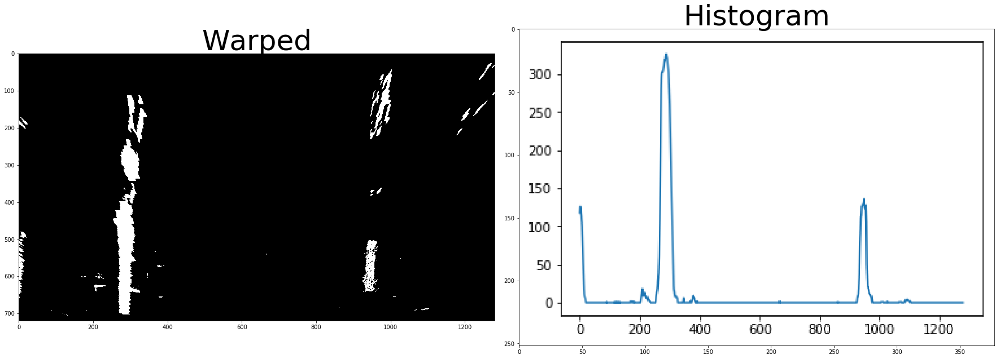

In [573]:
hist = mpimg.imread('output_images/hist.png')
print(hist.shape)
print2ims(warped, hist, text1 = 'Warped', text2 = 'Histogram')

In [576]:
def findFit(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    return left_fit, right_fit, nonzerox, nonzeroy, left_lane_inds, right_lane_inds

(720, 1280)


(720, 0)

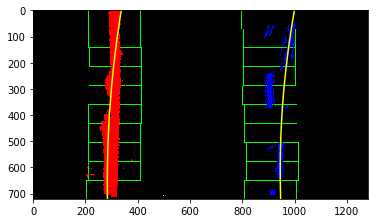

In [530]:
left_fit, right_fit, nonzerox, nonzeroy, left_lane_inds, right_lane_inds = findFit(warped)
# Generate x and y values for plotting
ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

In [542]:
def nextLines(binary_warped, left_fit, right_fit):
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
    left_fit[1]*nonzeroy + left_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
    right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    
    return left_fit, right_fit, nonzerox, nonzeroy, left_lane_inds, right_lane_inds

<class 'numpy.ndarray'>


(720, 0)

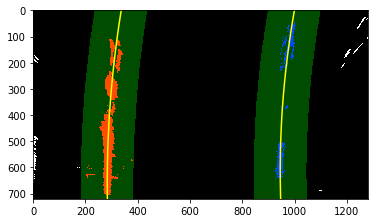

In [543]:
margin = 100
print(type(warped))
left_fit, right_fit, nonzerox, nonzeroy, left_lane_inds, right_lane_inds = nextLines(warped, left_fit, right_fit)

ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

# Create an image to draw on and an image to show the selection window
out_img = np.dstack((warped, warped, warped))*255
window_img = np.zeros_like(out_img)
# Color in left and right line pixels
out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

# Generate a polygon to illustrate the search window area
# And recast the x and y points into usable format for cv2.fillPoly()
left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
left_line_pts = np.hstack((left_line_window1, left_line_window2))
right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
right_line_pts = np.hstack((right_line_window1, right_line_window2))

# Draw the lane onto the warped blank image
cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
plt.imshow(result)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

In [552]:
def drawLines(binary_warped, left_fit, right_fit):
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    lines.addLeft(left_fitx)
    lines.addRight(right_fitx)
    left_fitx, right_fitx = lines.getMean()
    
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    #warp_zero = np.zeros_like(test5)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (binary_warped.shape[1], binary_warped.shape[0]), flags=cv2.INTER_LINEAR)
    
    left_curve, right_curve = findCurv(ploty, left_fitx, right_fitx)
    
    # ------- Find the curvature here and place it on the image: -------
        
    font = cv2.FONT_HERSHEY_SIMPLEX
    curvature = "Radius of Curvature: {} m".format(int((left_curve + right_curve)/2))
    cv2.putText(newwarp,curvature,(100,50), font, 1,(0,255,255),2)
    
    # ------- Find Car Position -----
    xm_per_pix = 3.7/700
    lane_center = (right_fitx[-1] + left_fitx[-1]) / 2.0 
    #line_center = (np.median(right_fitx) - np.median(left_fitx)) / 2.0 + np.median(left_fitx)
    camera_position = binary_warped.shape[1] / 2
    offset = (camera_position - lane_center) * xm_per_pix
    
    position = "Position offset: {: .4f} m".format((offset))
    cv2.putText(newwarp,position,(100,150), font, 1,(0,255,255),2)
    
    return newwarp

In [559]:
class Lines():
    def __init__(self):
        self.left_x = []
        self.right_x = []
        self.left_c = []
        self.right_c = []
        self.left_fit = []
        self.right_fit = []
        self.hasLine = False
        
    def addLeft(self, left):
        self.left_x.append(left)
        if(len(self.left_x) > 10):
            self.left_x = self.left_x[1:]
      
    def addRight(self, right):
        self.right_x.append(right)
        if(len(self.right_x) > 10):
            self.right_x = self.right_x[1:]
            
    def addFit(self, left_fit, right_fit):
        self.left_fit = left_fit
        self.right_fit = right_fit
            
    def addLeftCurve(self, left):
        self.left_c.append(left)
        if(len(self.left_c) > 15):
            self.left_c = self.left_c[1:]
            
    def addRightCurve(self, right):
        self.right_c.append(right)
        if(len(self.right_c) > 15):
            self.right_c = self.right_c[1:]
    
    def getMean(self):
        return sum(self.left_x)/len(self.left_x), sum(self.right_x)/len(self.right_x)
    
    def getCurve(self):
        return sum(self.left_c)/len(self.left_c), sum(self.right_c)/len(self.right_c)

In [464]:
def findCurv(ploty, left_fitx, right_fitx):
    y_eval = np.max(ploty)
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curve = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curve = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    return left_curve, right_curve

In [557]:
def process_image(image):
    
    undist = cal_undistort(image)
    combined = gradient_threshold(undist)
    warped = warp(combined)
    
    if(lines.hasLine):
        l_fit, r_fit, _, _, _, _ = nextLines(warped, lines.left_fit, lines.right_fit)
        lines.addFit(l_fit, r_fit)
    else:
        l_fit, r_fit, _, _, _, _ = findFit(warped)
        lines.addFit(l_fit, r_fit)
        lines.hasLine = True
    
    res = drawLines(warped, lines.left_fit, lines.right_fit)
    
    #_, _, _, _, lined = findLines(warped)
    # Combine the result with the original image
    result = cv2.addWeighted(image, 1, res, 0.3, 0)
    return result

(720, 1280)
(720, 1280)
(720, 1280)
(720, 1280)
(720, 1280)
(720, 1280)
(720, 1280)
(720, 1280)


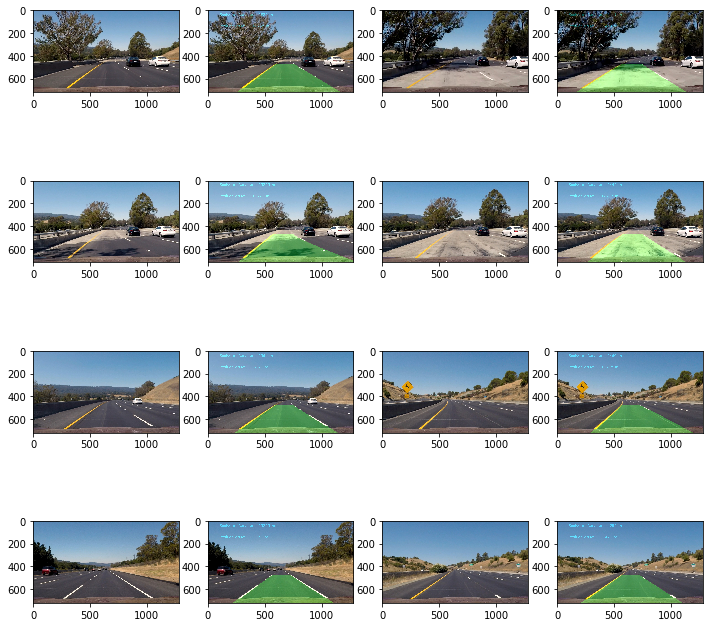

In [575]:
test = glob.glob('test_images/*.jpg')
count = 1
fig=plt.figure(figsize=(12, 12))
for img in test:
    lines = Lines()
    image = mpimg.imread(img)
    fig.add_subplot(4, 4, count)
    plt.imshow(image)
    count += 1
    
    res = process_image(image)
    fig.add_subplot(4, 4, count)
    plt.imshow(res, cmap = 'gray')
    count += 1
    
plt.show()

In [577]:
import imageio
imageio.plugins.ffmpeg.download()
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [578]:
lines = Lines()
output = 'project_video_output20-30.mp4'
## You may also uncomment the following line for a subclip of the first 5 seconds
clip1 = VideoFileClip("project_video.mp4").subclip(20,30)
#clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
white_clip.write_videofile(output, audio=False, verbose=False)



  0%|          | 0/251 [00:00<?, ?it/s]

  0%|          | 1/251 [00:00<01:16,  3.26it/s]

  1%|          | 2/251 [00:00<01:17,  3.20it/s]

  1%|          | 3/251 [00:00<01:15,  3.28it/s]

  2%|▏         | 4/251 [00:01<01:17,  3.18it/s]

  2%|▏         | 5/251 [00:01<01:16,  3.23it/s]

  2%|▏         | 6/251 [00:01<01:17,  3.17it/s]

  3%|▎         | 7/251 [00:02<01:18,  3.13it/s]

 62%|██████▏   | 155/251 [00:53<00:30,  3.13it/s]


100%|█████████▉| 250/251 [01:27<00:00,  3.46it/s]


In [579]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output))

In [562]:
lines = Lines()
output2 = 'project_video_output.mp4'
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip1 = VideoFileClip("project_video.mp4").subclip(20,30)
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
white_clip.write_videofile(output2, audio=False, verbose=False)



  0%|          | 0/1261 [00:00<?, ?it/s]

(720, 1280)




  0%|          | 1/1261 [00:00<07:03,  2.98it/s]

  0%|          | 2/1261 [00:00<07:07,  2.95it/s]

  0%|          | 3/1261 [00:00<06:52,  3.05it/s]

  0%|          | 4/1261 [00:01<06:54,  3.03it/s]

  0%|          | 5/1261 [00:01<06:52,  3.05it/s]

  0%|          | 6/1261 [00:01<06:41,  3.12it/s]

  1%|          | 7/1261 [00:02<06:41,  3.13it/s]

  1%|          | 8/1261 [00:02<06:31,  3.20it/s]

  1%|          | 9/1261 [00:02<06:36,  3.16it/s]

  1%|          | 10/1261 [00:03<06:21,  3.28it/s]

  1%|          | 11/1261 [00:03<06:35,  3.16it/s]

  1%|          | 12/1261 [00:03<06:29,  3.21it/s]

  1%|          | 13/1261 [00:04<06:17,  3.31it/s]

  1%|          | 14/1261 [00:04<06:16,  3.31it/s]

  1%|          | 15/1261 [00:04<06:20,  3.28it/s]

  1%|▏         | 16/1261 [00:04<06:12,  3.34it/s]

  1%|▏         | 17/1261 [00:05<07:45,  2.67it/s]

  1%|▏         | 18/1261 [00:05<07:26,  2.78it/s]

  2%|▏         | 19/1261 [00:06<07:21,  2.82it/s]

  2%|▏         | 20/1261 [00:06<07:07,

 11%|█▏        | 144/1261 [00:47<06:09,  3.03it/s]

 11%|█▏        | 145/1261 [00:47<05:54,  3.15it/s]

 12%|█▏        | 146/1261 [00:47<05:58,  3.11it/s]

 12%|█▏        | 147/1261 [00:48<05:53,  3.15it/s]

 12%|█▏        | 148/1261 [00:48<05:53,  3.15it/s]

 12%|█▏        | 149/1261 [00:48<05:44,  3.23it/s]

 12%|█▏        | 150/1261 [00:49<05:36,  3.30it/s]

 12%|█▏        | 151/1261 [00:49<05:30,  3.36it/s]

 12%|█▏        | 152/1261 [00:49<05:31,  3.34it/s]

 12%|█▏        | 153/1261 [00:49<05:38,  3.28it/s]

 12%|█▏        | 154/1261 [00:50<05:36,  3.29it/s]

 12%|█▏        | 155/1261 [00:50<05:37,  3.27it/s]

 12%|█▏        | 156/1261 [00:50<05:31,  3.33it/s]

 12%|█▏        | 157/1261 [00:51<05:33,  3.31it/s]

 13%|█▎        | 158/1261 [00:51<05:31,  3.33it/s]

 13%|█▎        | 159/1261 [00:51<05:30,  3.34it/s]

 13%|█▎        | 160/1261 [00:52<05:29,  3.34it/s]

 13%|█▎        | 161/1261 [00:52<05:25,  3.38it/s]

 13%|█▎        | 162/1261 [00:52<05:26,  3.36it/s]

 13%|█▎     

 23%|██▎       | 285/1261 [01:36<08:08,  2.00it/s]

 23%|██▎       | 286/1261 [01:36<09:43,  1.67it/s]

 23%|██▎       | 287/1261 [01:37<09:05,  1.78it/s]

 23%|██▎       | 288/1261 [01:37<08:52,  1.83it/s]

 23%|██▎       | 289/1261 [01:38<07:57,  2.04it/s]

 23%|██▎       | 290/1261 [01:38<07:56,  2.04it/s]

 23%|██▎       | 291/1261 [01:39<07:50,  2.06it/s]

 23%|██▎       | 292/1261 [01:39<07:31,  2.15it/s]

 23%|██▎       | 293/1261 [01:40<06:54,  2.33it/s]

 23%|██▎       | 294/1261 [01:40<06:40,  2.42it/s]

 23%|██▎       | 295/1261 [01:40<06:28,  2.49it/s]

 23%|██▎       | 296/1261 [01:41<06:29,  2.48it/s]

 24%|██▎       | 297/1261 [01:41<06:21,  2.52it/s]

 24%|██▎       | 298/1261 [01:41<06:21,  2.53it/s]

 24%|██▎       | 299/1261 [01:42<06:14,  2.57it/s]

 24%|██▍       | 300/1261 [01:42<05:58,  2.68it/s]

 24%|██▍       | 301/1261 [01:43<05:54,  2.71it/s]

 24%|██▍       | 302/1261 [01:43<06:01,  2.65it/s]

 24%|██▍       | 303/1261 [01:43<05:54,  2.70it/s]

 24%|██▍    

 34%|███▍      | 426/1261 [02:23<04:02,  3.44it/s]

 34%|███▍      | 427/1261 [02:23<03:57,  3.51it/s]

 34%|███▍      | 428/1261 [02:23<03:54,  3.55it/s]

 34%|███▍      | 429/1261 [02:23<03:53,  3.57it/s]

 34%|███▍      | 430/1261 [02:24<03:50,  3.61it/s]

 34%|███▍      | 431/1261 [02:24<03:49,  3.62it/s]

 34%|███▍      | 432/1261 [02:24<03:48,  3.63it/s]

 34%|███▍      | 433/1261 [02:24<03:51,  3.58it/s]

 34%|███▍      | 434/1261 [02:25<03:53,  3.54it/s]

 34%|███▍      | 435/1261 [02:25<03:53,  3.54it/s]

 35%|███▍      | 436/1261 [02:25<04:00,  3.42it/s]

 35%|███▍      | 437/1261 [02:26<03:53,  3.52it/s]

 35%|███▍      | 438/1261 [02:26<03:57,  3.46it/s]

 35%|███▍      | 439/1261 [02:26<04:03,  3.38it/s]

 35%|███▍      | 440/1261 [02:26<03:54,  3.50it/s]

 35%|███▍      | 441/1261 [02:27<03:53,  3.51it/s]

 35%|███▌      | 442/1261 [02:27<04:04,  3.36it/s]

 35%|███▌      | 443/1261 [02:27<03:55,  3.48it/s]

 35%|███▌      | 444/1261 [02:28<03:50,  3.54it/s]

 35%|███▌   

 45%|████▍     | 567/1261 [03:04<03:16,  3.54it/s]

 45%|████▌     | 568/1261 [03:05<03:15,  3.54it/s]

 45%|████▌     | 569/1261 [03:05<03:12,  3.60it/s]

 45%|████▌     | 570/1261 [03:05<03:09,  3.64it/s]

 45%|████▌     | 571/1261 [03:05<03:22,  3.41it/s]

 45%|████▌     | 572/1261 [03:06<03:45,  3.06it/s]

 45%|████▌     | 573/1261 [03:06<03:34,  3.21it/s]

 46%|████▌     | 574/1261 [03:06<03:27,  3.31it/s]

 46%|████▌     | 575/1261 [03:07<03:21,  3.40it/s]

 46%|████▌     | 576/1261 [03:07<03:21,  3.41it/s]

 46%|████▌     | 577/1261 [03:07<03:18,  3.44it/s]

 46%|████▌     | 578/1261 [03:08<03:16,  3.48it/s]

 46%|████▌     | 579/1261 [03:08<03:10,  3.58it/s]

 46%|████▌     | 580/1261 [03:08<03:13,  3.52it/s]

 46%|████▌     | 581/1261 [03:08<03:13,  3.52it/s]

 46%|████▌     | 582/1261 [03:09<03:08,  3.59it/s]

 46%|████▌     | 583/1261 [03:09<03:05,  3.65it/s]

 46%|████▋     | 584/1261 [03:09<03:10,  3.56it/s]

 46%|████▋     | 585/1261 [03:09<03:09,  3.56it/s]

 46%|████▋  

 56%|█████▌    | 708/1261 [03:49<02:36,  3.53it/s]

 56%|█████▌    | 709/1261 [03:49<02:38,  3.48it/s]

 56%|█████▋    | 710/1261 [03:49<02:42,  3.39it/s]

 56%|█████▋    | 711/1261 [03:50<02:43,  3.37it/s]

 56%|█████▋    | 712/1261 [03:50<02:50,  3.22it/s]

 57%|█████▋    | 713/1261 [03:51<03:40,  2.48it/s]

 57%|█████▋    | 714/1261 [03:51<03:23,  2.69it/s]

 57%|█████▋    | 715/1261 [03:51<03:11,  2.85it/s]

 57%|█████▋    | 716/1261 [03:52<03:20,  2.71it/s]

 57%|█████▋    | 717/1261 [03:52<03:16,  2.77it/s]

 57%|█████▋    | 718/1261 [03:52<03:31,  2.57it/s]

 57%|█████▋    | 719/1261 [03:53<03:59,  2.26it/s]

 57%|█████▋    | 720/1261 [03:53<04:06,  2.19it/s]

 57%|█████▋    | 721/1261 [03:54<03:43,  2.42it/s]

 57%|█████▋    | 722/1261 [03:54<03:29,  2.57it/s]

 57%|█████▋    | 723/1261 [03:55<03:57,  2.27it/s]

 57%|█████▋    | 724/1261 [03:55<04:05,  2.18it/s]

 57%|█████▋    | 725/1261 [03:56<04:17,  2.08it/s]

 58%|█████▊    | 726/1261 [03:56<04:07,  2.16it/s]

 58%|█████▊ 

 67%|██████▋   | 849/1261 [04:36<02:29,  2.76it/s]

 67%|██████▋   | 850/1261 [04:36<02:29,  2.75it/s]

 67%|██████▋   | 851/1261 [04:36<02:27,  2.79it/s]

 68%|██████▊   | 852/1261 [04:37<02:19,  2.94it/s]

 68%|██████▊   | 853/1261 [04:37<02:22,  2.87it/s]

 68%|██████▊   | 854/1261 [04:37<02:22,  2.85it/s]

 68%|██████▊   | 855/1261 [04:38<02:20,  2.88it/s]

 68%|██████▊   | 856/1261 [04:38<02:20,  2.88it/s]

 68%|██████▊   | 857/1261 [04:38<02:14,  3.01it/s]

 68%|██████▊   | 858/1261 [04:39<02:18,  2.91it/s]

 68%|██████▊   | 859/1261 [04:39<02:10,  3.08it/s]

 68%|██████▊   | 860/1261 [04:39<02:03,  3.25it/s]

 68%|██████▊   | 861/1261 [04:40<01:58,  3.38it/s]

 68%|██████▊   | 862/1261 [04:40<01:56,  3.44it/s]

 68%|██████▊   | 863/1261 [04:40<01:51,  3.56it/s]

 69%|██████▊   | 864/1261 [04:40<01:48,  3.65it/s]

 69%|██████▊   | 865/1261 [04:41<01:49,  3.63it/s]

 69%|██████▊   | 866/1261 [04:41<01:49,  3.62it/s]

 69%|██████▉   | 867/1261 [04:41<01:48,  3.64it/s]

 69%|██████▉

 79%|███████▊  | 990/1261 [05:24<01:55,  2.35it/s]

 79%|███████▊  | 991/1261 [05:25<02:08,  2.11it/s]

 79%|███████▊  | 992/1261 [05:26<02:15,  1.98it/s]

 79%|███████▊  | 993/1261 [05:26<02:11,  2.04it/s]

 79%|███████▉  | 994/1261 [05:27<02:20,  1.90it/s]

 79%|███████▉  | 995/1261 [05:27<02:18,  1.92it/s]

 79%|███████▉  | 996/1261 [05:28<02:08,  2.06it/s]

 79%|███████▉  | 997/1261 [05:28<02:02,  2.15it/s]

 79%|███████▉  | 998/1261 [05:28<02:03,  2.14it/s]

 79%|███████▉  | 999/1261 [05:29<01:53,  2.31it/s]

 79%|███████▉  | 1000/1261 [05:29<01:42,  2.54it/s]

 79%|███████▉  | 1001/1261 [05:29<01:34,  2.74it/s]

 79%|███████▉  | 1002/1261 [05:30<01:31,  2.83it/s]

 80%|███████▉  | 1003/1261 [05:30<01:28,  2.92it/s]

 80%|███████▉  | 1004/1261 [05:30<01:28,  2.91it/s]

 80%|███████▉  | 1005/1261 [05:31<01:27,  2.94it/s]

 80%|███████▉  | 1006/1261 [05:31<01:49,  2.33it/s]

 80%|███████▉  | 1007/1261 [05:32<02:16,  1.86it/s]

 80%|███████▉  | 1008/1261 [05:33<02:08,  1.97it/s]

 80

 90%|████████▉ | 1129/1261 [06:16<00:42,  3.12it/s]

 90%|████████▉ | 1130/1261 [06:16<00:42,  3.12it/s]

 90%|████████▉ | 1131/1261 [06:16<00:48,  2.67it/s]

 90%|████████▉ | 1132/1261 [06:17<00:47,  2.69it/s]

 90%|████████▉ | 1133/1261 [06:17<00:44,  2.85it/s]

 90%|████████▉ | 1134/1261 [06:17<00:48,  2.64it/s]

 90%|█████████ | 1135/1261 [06:18<00:46,  2.70it/s]

 90%|█████████ | 1136/1261 [06:18<00:45,  2.77it/s]

 90%|█████████ | 1137/1261 [06:18<00:43,  2.87it/s]

 90%|█████████ | 1138/1261 [06:19<00:42,  2.91it/s]

 90%|█████████ | 1139/1261 [06:19<00:40,  3.03it/s]

 90%|█████████ | 1140/1261 [06:20<00:43,  2.79it/s]

 90%|█████████ | 1141/1261 [06:20<00:41,  2.92it/s]

 91%|█████████ | 1142/1261 [06:20<00:39,  2.98it/s]

 91%|█████████ | 1143/1261 [06:21<00:40,  2.91it/s]

 91%|█████████ | 1144/1261 [06:21<00:39,  2.97it/s]

 91%|█████████ | 1145/1261 [06:21<00:39,  2.94it/s]

 91%|█████████ | 1146/1261 [06:22<00:38,  2.97it/s]

 91%|█████████ | 1147/1261 [06:22<00:38,  2.94

In [563]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(output2))